# 1. Temporal Analysis of Groundwater Levels

### Objective: Understand how groundwater levels have changed over the years and months.

### Method:
1. Calculate yearly averages for each ward to identify long-term trends.
2. Calculate monthly averages across years to observe seasonal fluctuations.
3. Plot time-series graphs to visualize changes.

### Insights:
Identify declining trends that indicate over-extraction or weak recharge.
Detect seasonal patterns (e.g., post-monsoon recharge, pre-monsoon depletion).


# CODE 1 - FOR EACH YEAR DATASET

In [10]:
import pandas as pd
import matplotlib.pyplot as plt

In [11]:
# Load the dataset
file_path = "chennai-ground-water-levels-2023.csv"  # Replace with your file path
df = pd.read_csv(file_path)

In [12]:
df.head()

,S.No.,Area No.,Dept No.,Location,Jan,Feb,Mar,Apr,May,Jun,Jul,Aug,Sep,Oct,Nov,Dec
0,1.0,I,1.0,Kathivakkam,1.48,1.520,1.462,1.50,1.53,1.554,1.688,1.599,1.610,1.53,1.29,1.38
1,2.0,I,2.0,Kathivakkam,3.26,3.293,3.310,3.36,3.36,3.382,3.416,3.459,3.470,3.48,3.35,3.268
2,3.0,I,3.0,Ernavoor,2.01,2.236,2.244,2.24,2.14,2.166,2.231,2.51,2.264,2.24,1.82,1.91
3,4.0,I,4.0,Sadaiyankuppam,3.67,3.745,3.661,3.66,3.65,3.638,3.808,4.01,3.646,3.67,3.27,3.125
4,5.0,I,5.0,Kamadhenu Nagar,3.45,3.492,3.439,3.31,3.41,3.151,3.499,3.28,3.393,3.2,3.07,3.157


In [17]:
# Step 1: Data Preparation
# Ensure the data has columns: "Location", "Jan", "Feb", ..., "Dec"
monthly_columns = ["Jan ", "Feb", "Mar", "Apr ", "May", "Jun", "Jul", "Aug", "Sep", "Oct", "Nov", "Dec"]

In [19]:
# Convert monthly columns to numeric, replacing non-numeric values with NaN
df[monthly_columns] = df[monthly_columns].apply(pd.to_numeric, errors='coerce')

# Step 2: Calculate Yearly Averages for Each Ward
df["Yearly Average"] = df[monthly_columns].mean(axis=1)

In [20]:
# Step 3: Calculate Monthly Averages Across All Wards
monthly_averages = df[monthly_columns].mean(axis=0)

C:\Users\rumma\AppData\Local\Temp\ipykernel_18480\896260781.py:13: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


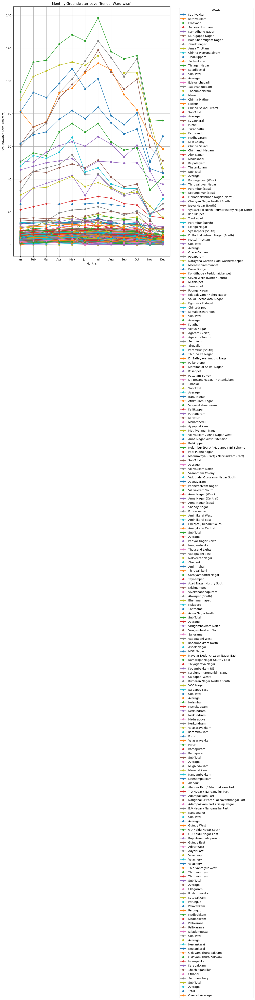

In [25]:
# Step 4: Visualize Yearly Trends for Each Ward
plt.figure(figsize=(10, 16))
for _, row in df.iterrows():
    ward_name = row["Location"]
    yearly_trend = row[monthly_columns]
    plt.plot(monthly_columns, yearly_trend, label=ward_name, marker='o')

plt.title("Monthly Groundwater Level Trends (Ward-wise)")
plt.xlabel("Months")
plt.ylabel("Groundwater Level (meters)")
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', title="Wards")
plt.grid()
plt.tight_layout()
plt.show()

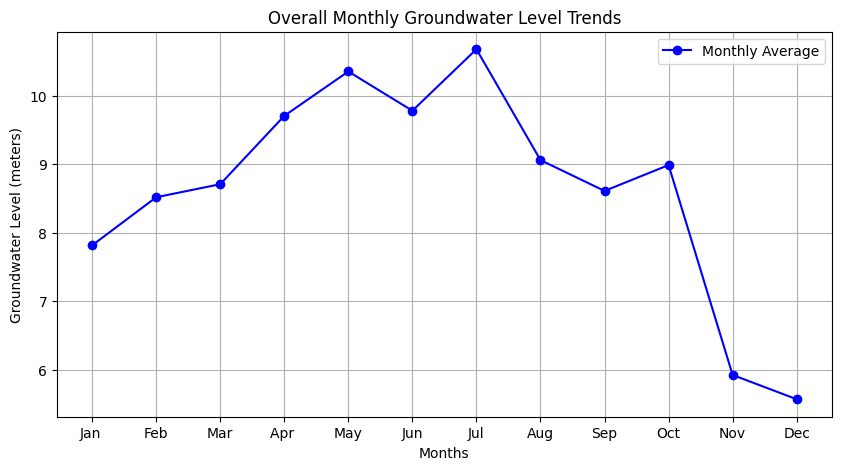

In [26]:
# Step 5: Visualize Overall Monthly Averages
plt.figure(figsize=(10, 5))
plt.plot(monthly_columns, monthly_averages, marker='o', color='b', label="Monthly Average")
plt.title("Overall Monthly Groundwater Level Trends")
plt.xlabel("Months")
plt.ylabel("Groundwater Level (meters)")
plt.grid()
plt.legend()
plt.show()

In [27]:
# Step 6: Display Key Insights
print("Yearly Averages Per Ward:")
print(df[["Location", "Yearly Average"]])

print("\nOverall Monthly Averages:")
print(monthly_averages)

Yearly Averages Per Ward:
             Location  Yearly Average
0         Kathivakkam        1.511917
1         Kathivakkam        3.367333
2            Ernavoor        2.167583
3      Sadaiyankuppam        3.629417
4     Kamadhenu Nagar        3.320917
..                ...             ...
227       Semmenchery        3.961333
228         Sub Total       32.677667
229           Average        3.675243
230             Total       68.321155
231  Over all Average        4.554744

[232 rows x 2 columns]

Overall Monthly Averages:
Jan      7.815062
Feb      8.517595
Mar      8.707943
Apr      9.705862
May     10.353571
Jun      9.780664
Jul     10.678627
Aug      9.060182
Sep      8.609781
Oct      8.987451
Nov      5.923075
Dec      5.568974
dtype: float64


## Explanation of Code

#### Data Loading:

Reads the CSV file containing groundwater data. Ensure it has Location and Jan to Dec columns.

#### Yearly Averages:

Calculates the average groundwater level across all months for each ward and stores it in a new column, Yearly Average.

#### Monthly Averages:

Computes the average groundwater level across all wards for each month.

#### Visualization:

Ward-wise Trends: Plots individual monthly trends for each ward to observe temporal changes.
Overall Monthly Averages: Plots monthly averages to visualize seasonal variations.

#### Insights:

Displays calculated yearly averages for wards and monthly averages across all wards.


## Output
#### Ward-wise Trends Plot:

A time-series graph showing monthly groundwater levels for each ward.
#### Overall Monthly Averages Plot:

A single line chart indicating average groundwater levels for each month across all wards.
#### Key Metrics:

Prints yearly averages per ward and overall monthly averages.

----

# CODE 2 - OVERALL 3 YEARS

In [2]:
import pandas as pd
import matplotlib.pyplot as plt

In [4]:
# File paths for the 3 years (update with actual paths)
file_path_2021 = "./dataset/chennai-ground-water-levels-2021.csv"  # Replace with your file path for 2021
file_path_2022 = "./dataset/chennai-ground-water-levels-2022.csv"  # Replace with your file path for 2022
file_path_2023 = "./dataset/chennai-ground-water-levels-2023.csv"  # Replace with your file path for 2023

In [5]:
# Load the datasets for 2021, 2022, and 2023
df_2021 = pd.read_csv(file_path_2021)
df_2022 = pd.read_csv(file_path_2022)
df_2023 = pd.read_csv(file_path_2023)

In [6]:
# List of monthly columns
monthly_columns = ["Jan ", "Feb", "Mar", "Apr ", "May", "Jun", "Jul", "Aug", "Sep", "Oct", "Nov", "Dec"]

In [7]:
# Data Preparation: Ensure all datasets have the necessary columns
def prepare_data(df):
    df[monthly_columns] = df[monthly_columns].apply(pd.to_numeric, errors='coerce')
    df["Yearly Average"] = df[monthly_columns].mean(axis=1)
    return df

# Apply data preparation to all datasets
df_2021 = prepare_data(df_2021)
df_2022 = prepare_data(df_2022)
df_2023 = prepare_data(df_2023)

In [8]:
# Add Year Column for Identification
df_2021["Year"] = 2021
df_2022["Year"] = 2022
df_2023["Year"] = 2023

In [9]:
# Combine the datasets for 3 years
df_all_years = pd.concat([df_2021, df_2022, df_2023])

In [10]:
# Step 3: Calculate Monthly Averages Across All Wards for all years combined
monthly_averages_all_years = df_all_years.groupby("Year")[monthly_columns].mean()

C:\Users\rumma\AppData\Local\Temp\ipykernel_3864\1744941347.py:13: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


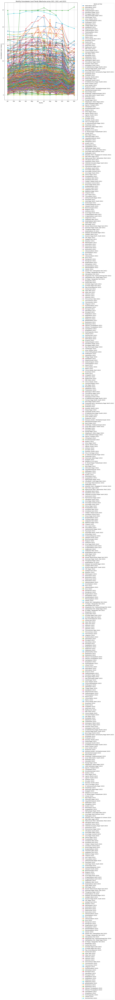

In [11]:
# Step 4: Visualize Yearly Trends for Each Ward (Across All Years)
plt.figure(figsize=(12, 16))
for _, row in df_all_years.iterrows():
    ward_name = row["Location"]
    yearly_trend = row[monthly_columns]
    plt.plot(monthly_columns, yearly_trend, label=f"{ward_name} ({row['Year']})", marker='o')

plt.title("Monthly Groundwater Level Trends (Ward-wise across 2021, 2022, and 2023)")
plt.xlabel("Months")
plt.ylabel("Groundwater Level (meters)")
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', title="Wards and Year")
plt.grid()
plt.tight_layout()
plt.show()


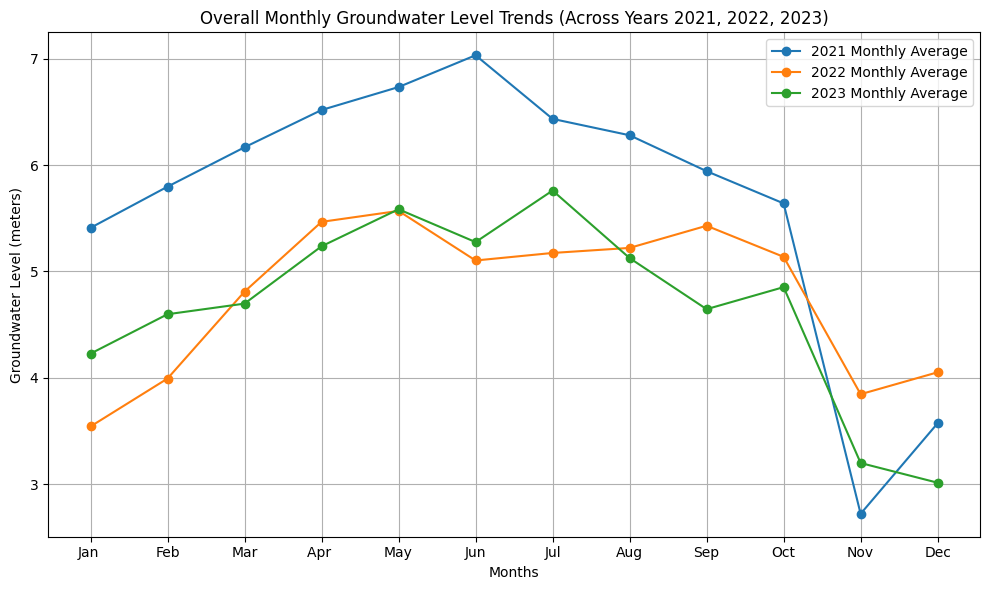

In [12]:
# Step 5: Visualize Overall Monthly Averages for Each Year
plt.figure(figsize=(10, 6))
for year in [2021, 2022, 2023]:
    plt.plot(monthly_columns, monthly_averages_all_years.loc[year], marker='o', label=f"{year} Monthly Average")

plt.title("Overall Monthly Groundwater Level Trends (Across Years 2021, 2022, 2023)")
plt.xlabel("Months")
plt.ylabel("Groundwater Level (meters)")
plt.legend()
plt.grid()
plt.tight_layout()
plt.show()

In [13]:
# Step 6: Display Yearly Averages Per Ward for all years
print("Yearly Averages Per Ward (Across All Years):")
print(df_all_years[["Location", "Year", "Yearly Average"]])

# Step 7: Display Overall Monthly Averages for Each Year
print("\nOverall Monthly Averages for Each Year:")
print(monthly_averages_all_years)

Yearly Averages Per Ward (Across All Years):
            Location  Year  Yearly Average
0        Kathivakkam  2021        1.788182
1        Kathivakkam  2021        3.213250
2           Ernavoor  2021        2.277083
3     Sadaiyankuppam  2021        3.478167
4    Kamadhenu Nagar  2021        3.776333
..               ...   ...             ...
195      Injampakkam  2023        6.208333
196       Karapakkam  2023        4.104333
197  Shozhinganallur  2023        5.921417
198          Uthandi  2023        1.846091
199      Semmenchery  2023        3.961333

[600 rows x 3 columns]

Overall Monthly Averages for Each Year:
          Jan        Feb       Mar      Apr        May       Jun       Jul  \
Year                                                                         
2021  5.409300  5.796600  6.167050  6.517600  6.733500  7.032550  6.434100   
2022  3.541206  3.991909  4.809385  5.465670  5.568550  5.102271  5.173106   
2023  4.226146  4.596798  4.696668  5.235829  5.584171  5.2752

# CODE 3 - BEST VISUALIZATION OF 3 YEARS

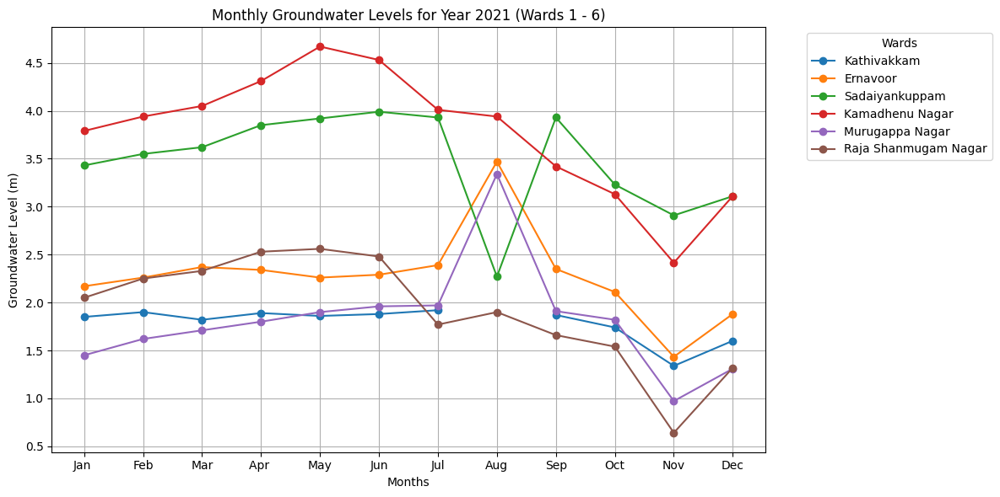

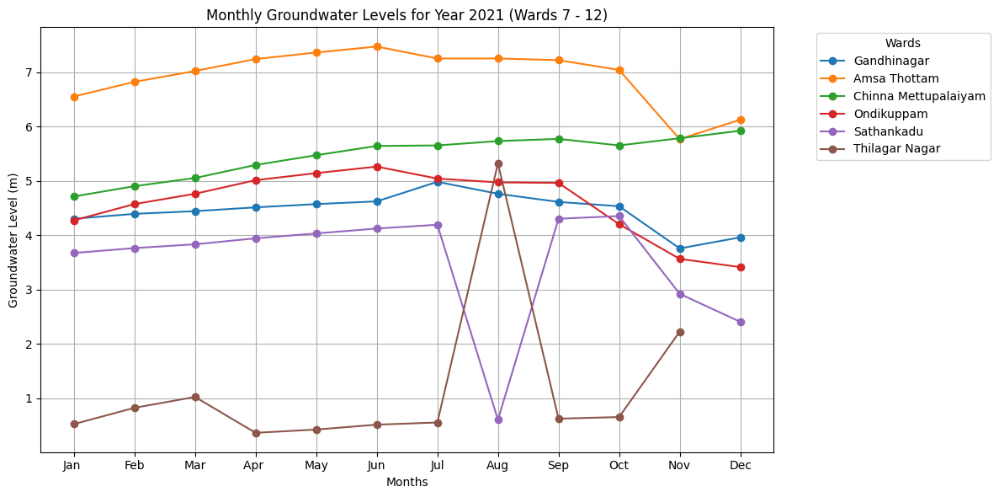

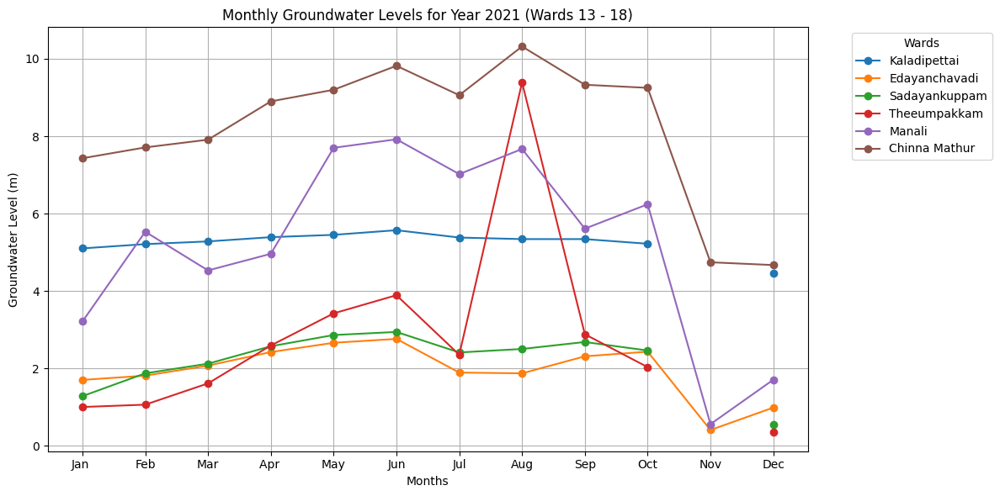

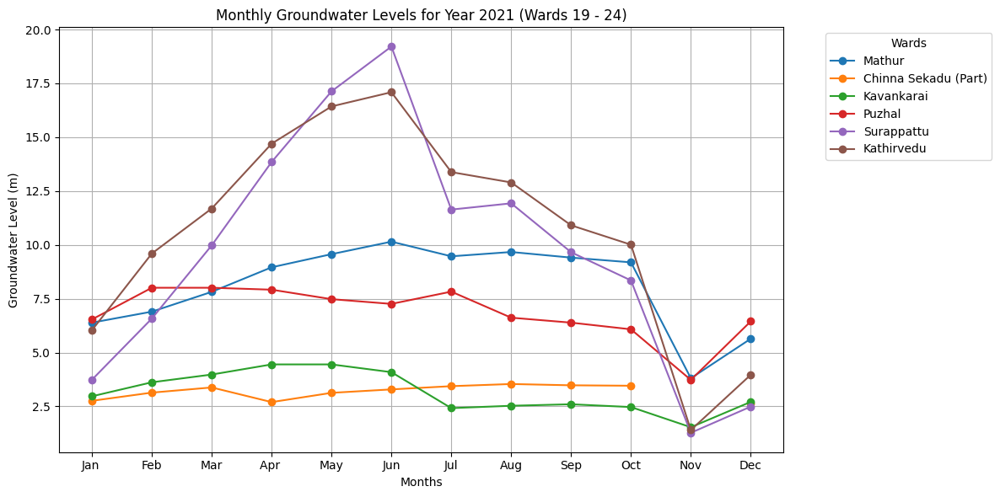

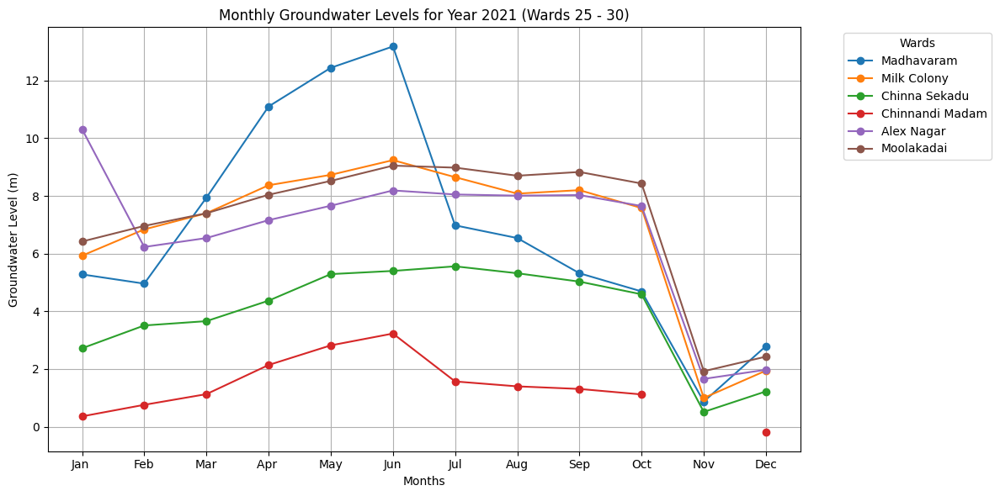

...

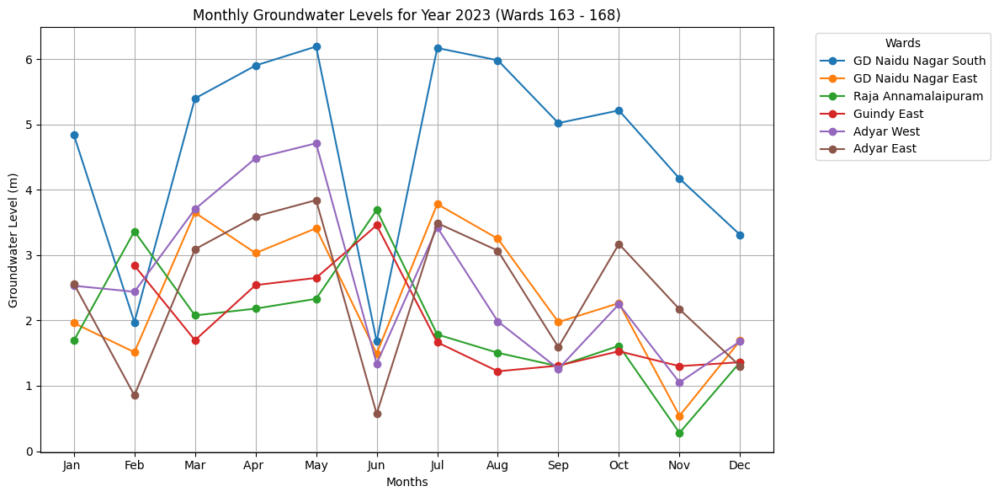

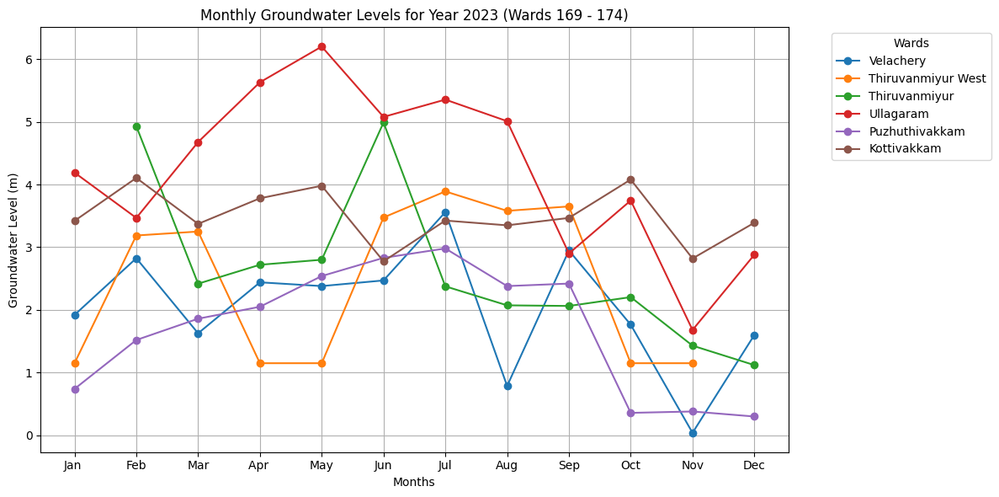

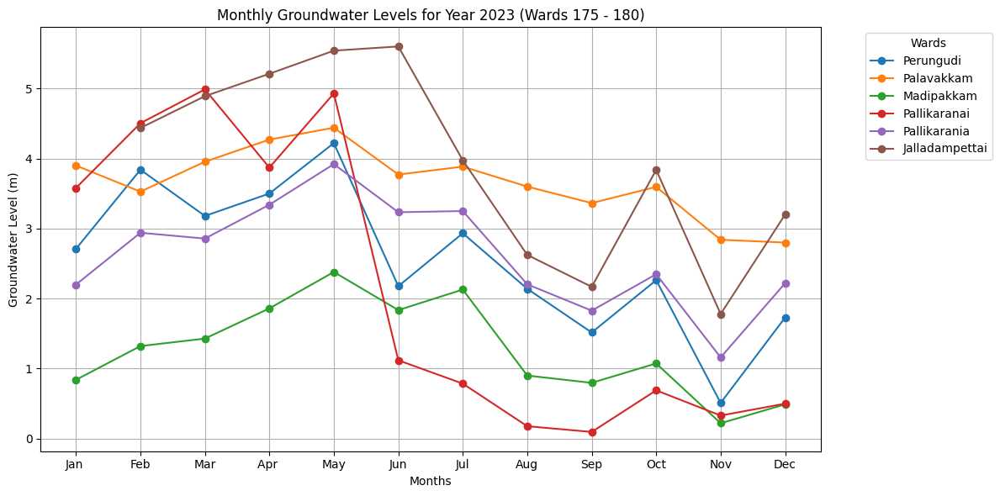

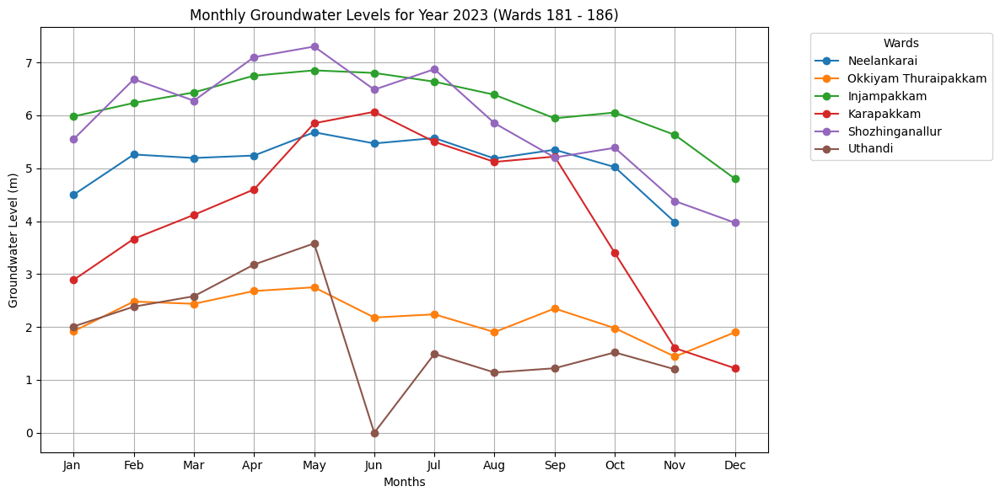

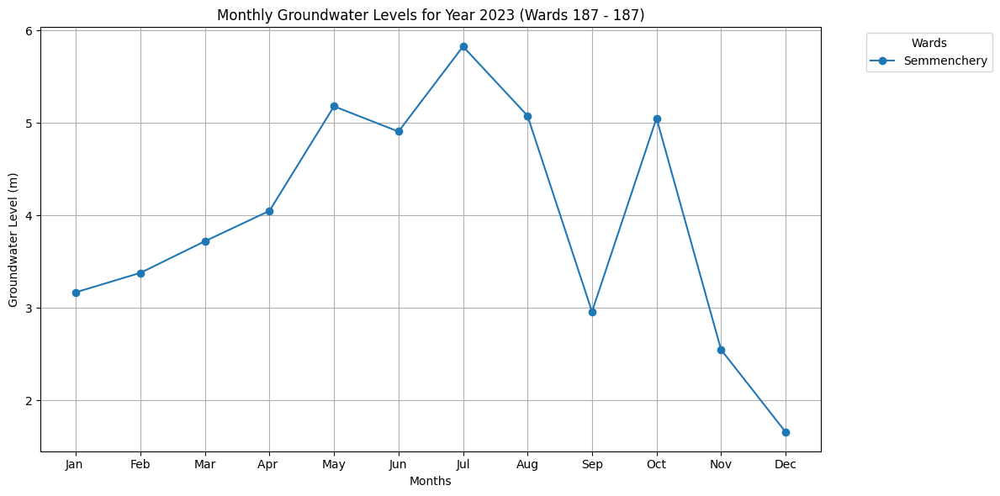

Yearly Averages Per Ward (Across All Years):
            Location  Year  Yearly Average
0        Kathivakkam  2021        1.788182
1        Kathivakkam  2021        3.213250
2           Ernavoor  2021        2.277083
3     Sadaiyankuppam  2021        3.478167
4    Kamadhenu Nagar  2021        3.776333
..               ...   ...             ...
195      Injampakkam  2023        6.208333
196       Karapakkam  2023        4.104333
197  Shozhinganallur  2023        5.921417
198          Uthandi  2023        1.846091
199      Semmenchery  2023        3.961333

[600 rows x 3 columns]

Overall Monthly Averages for Each Year:
          Jan        Feb       Mar      Apr        May       Jun       Jul  \
Year                                                                         
2021  5.409300  5.796600  6.167050  6.517600  6.733500  7.032550  6.434100   
2022  3.541206  3.991909  4.809385  5.465670  5.568550  5.102271  5.173106   
2023  4.226146  4.596798  4.696668  5.235829  5.584171  5.2752

In [17]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

# File paths for the 3 years (update with actual paths)
file_path_2021 = "./dataset/chennai-ground-water-levels-2021.csv"  # Replace with your file path for 2021
file_path_2022 = "./dataset/chennai-ground-water-levels-2022.csv"  # Replace with your file path for 2022
file_path_2023 = "./dataset/chennai-ground-water-levels-2023.csv"  # Replace with your file path for 2023

# Load the datasets for 2021, 2022, and 2023
df_2021 = pd.read_csv(file_path_2021)
df_2022 = pd.read_csv(file_path_2022)
df_2023 = pd.read_csv(file_path_2023)

# List of monthly columns
monthly_columns = ["Jan ", "Feb", "Mar", "Apr ", "May", "Jun", "Jul", "Aug", "Sep", "Oct", "Nov", "Dec"]

# Data Preparation: Ensure all datasets have the necessary columns
def prepare_data(df):
    df[monthly_columns] = df[monthly_columns].apply(pd.to_numeric, errors='coerce')
    df["Yearly Average"] = df[monthly_columns].mean(axis=1)
    return df

# Apply data preparation to all datasets
df_2021 = prepare_data(df_2021)
df_2022 = prepare_data(df_2022)
df_2023 = prepare_data(df_2023)

# Add Year Column for Identification
df_2021["Year"] = 2021
df_2022["Year"] = 2022
df_2023["Year"] = 2023

# Combine the datasets for 3 years
df_all_years = pd.concat([df_2021, df_2022, df_2023])

# Step 3: Split Locations into Groups of 6
locations = df_all_years["Location"].unique()
num_plots = int(np.ceil(len(locations) / 6))  # Calculate number of plots needed

# Loop through each year and generate plots
years = [2021, 2022, 2023]
for year in years:
    df_year = df_all_years[df_all_years["Year"] == year]  # Filter data for the specific year

    for i in range(num_plots):
        plt.figure(figsize=(12, 6))
        
        start_idx = i * 6
        end_idx = start_idx + 6
        for location in locations[start_idx:end_idx]:  # Select 6 locations for each plot
            subset = df_year[df_year["Location"] == location]
            
            # Ensure we're using the correct row for this location and year
            values = subset[monthly_columns].iloc[0].values  # Access values directly for plotting
            
            plt.plot(monthly_columns, values, marker='o', label=location)

        plt.xlabel("Months")
        plt.ylabel("Groundwater Level (m)")
        plt.title(f"Monthly Groundwater Levels for Year {year} (Wards {start_idx + 1} - {min(end_idx, len(locations))})")
        plt.legend(loc='upper left', bbox_to_anchor=(1.05, 1), title="Wards")
        plt.grid()
        plt.tight_layout()
        plt.show()

# Step 4: Display Yearly Averages Per Ward (Optional)
print("Yearly Averages Per Ward (Across All Years):")
print(df_all_years[["Location", "Year", "Yearly Average"]])

# Step 5: Display Overall Monthly Averages for Each Year (Optional)
monthly_averages_all_years = df_all_years.groupby("Year")[monthly_columns].mean()
print("\nOverall Monthly Averages for Each Year:")
print(monthly_averages_all_years)


# CODE 4 - COVERING ALL 4 YEARS - 2021 TO MARCH 24

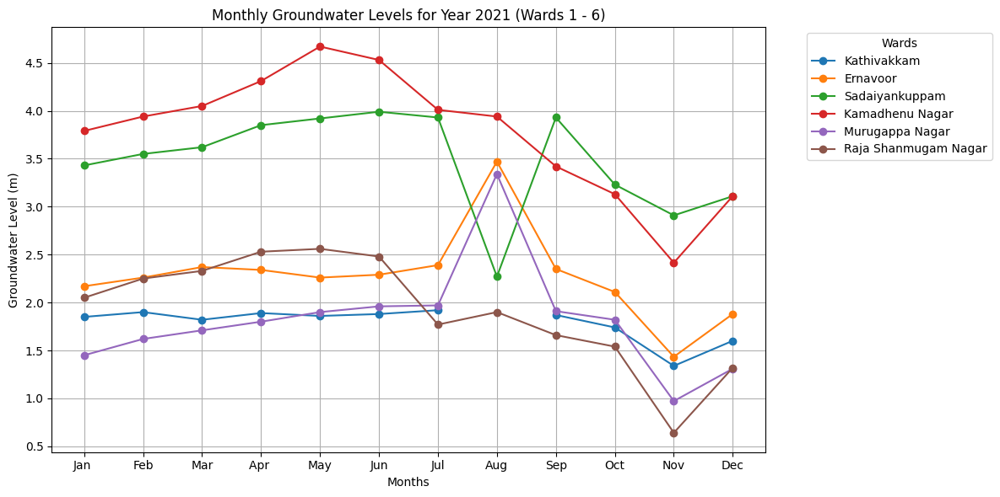

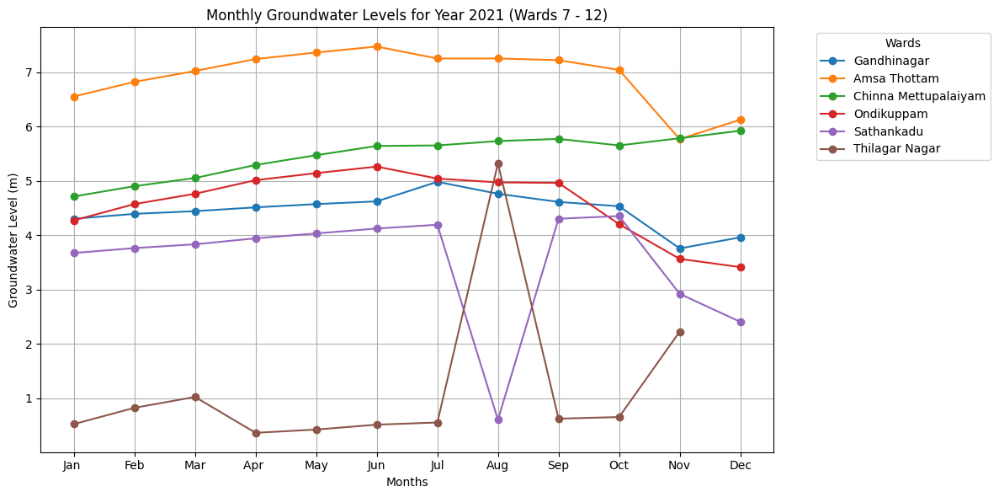

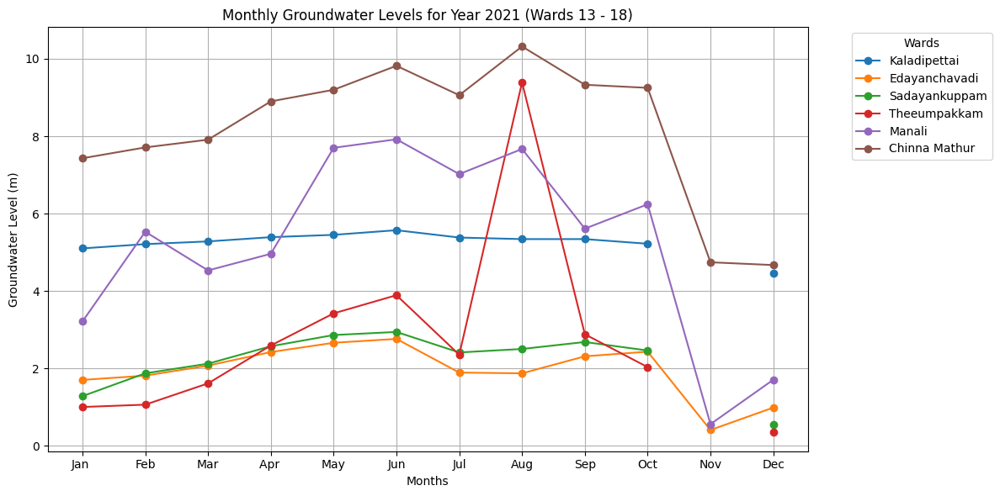

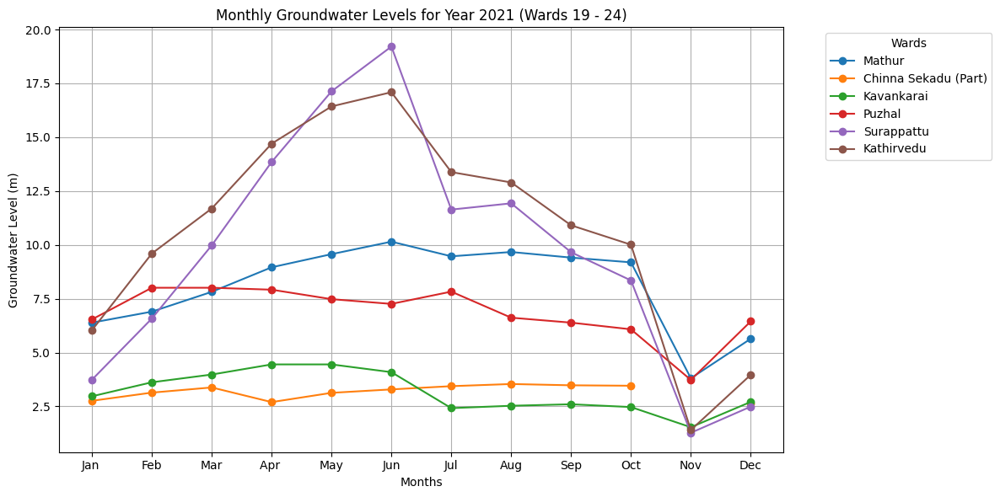

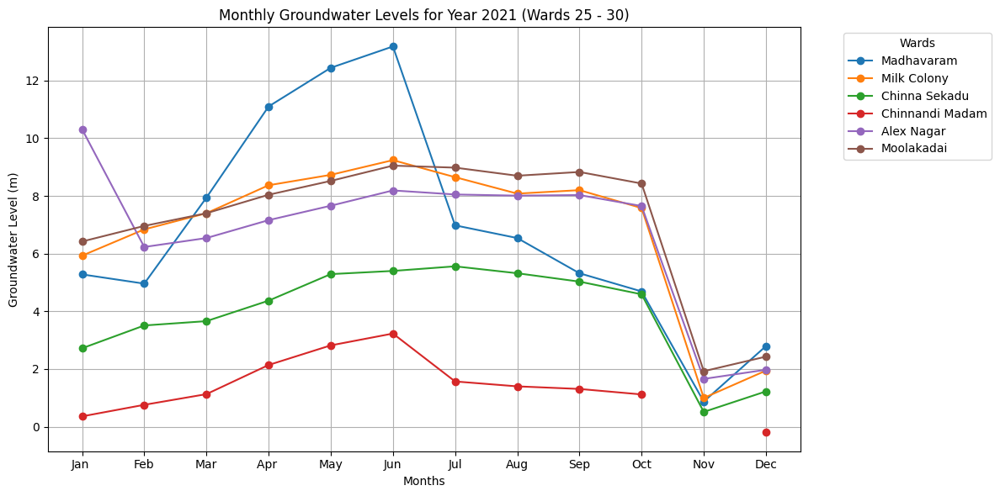

...

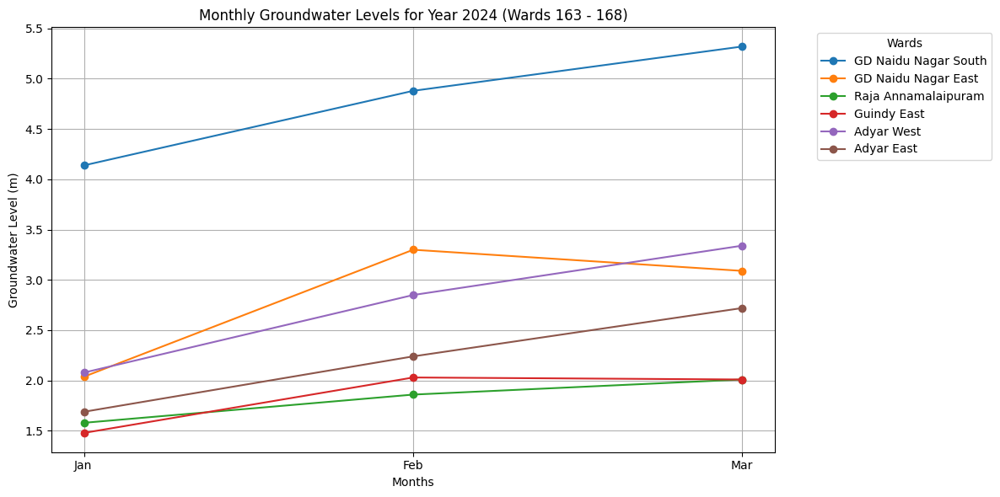

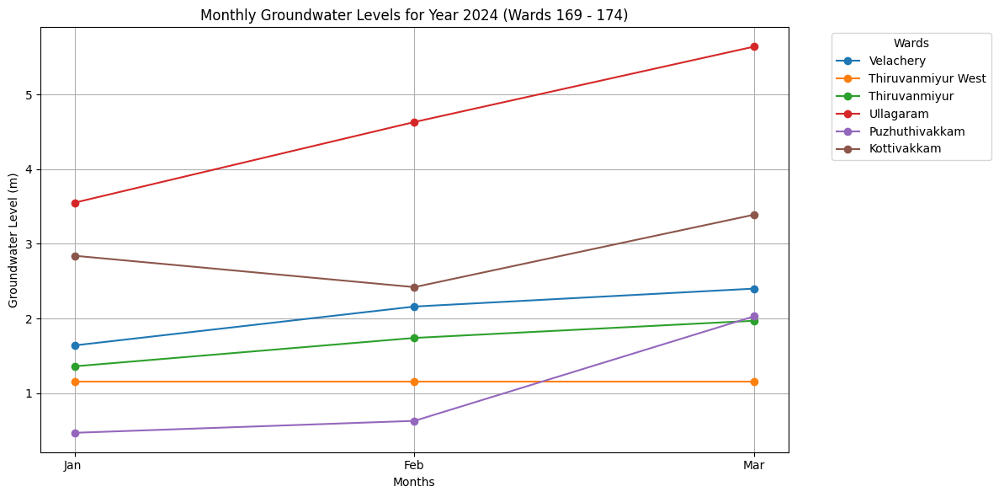

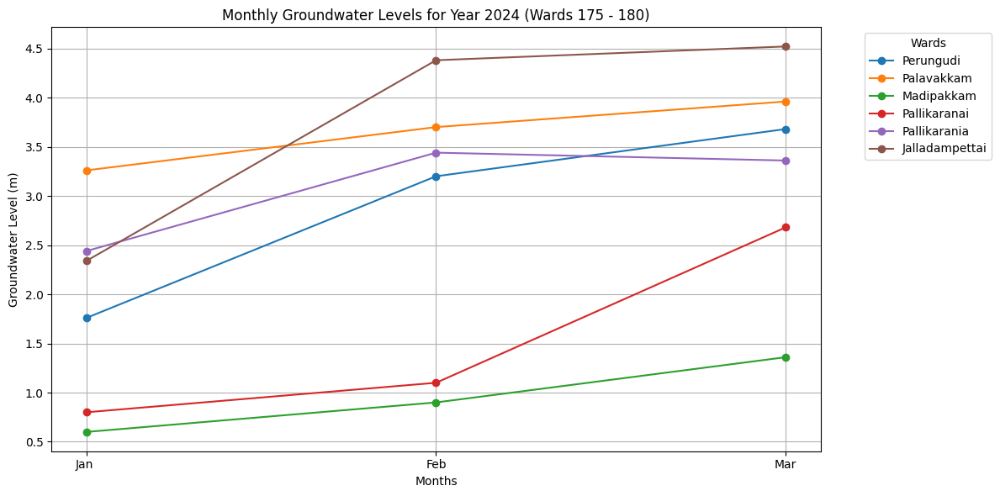

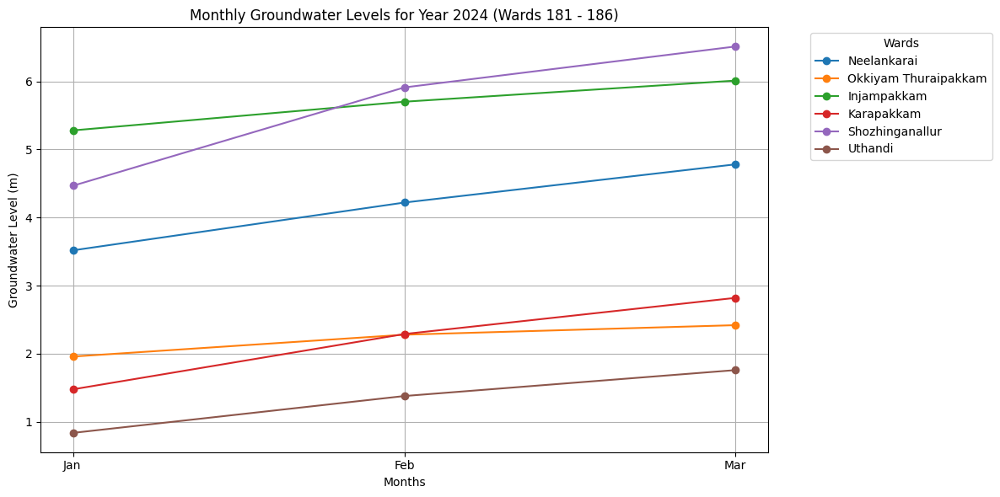

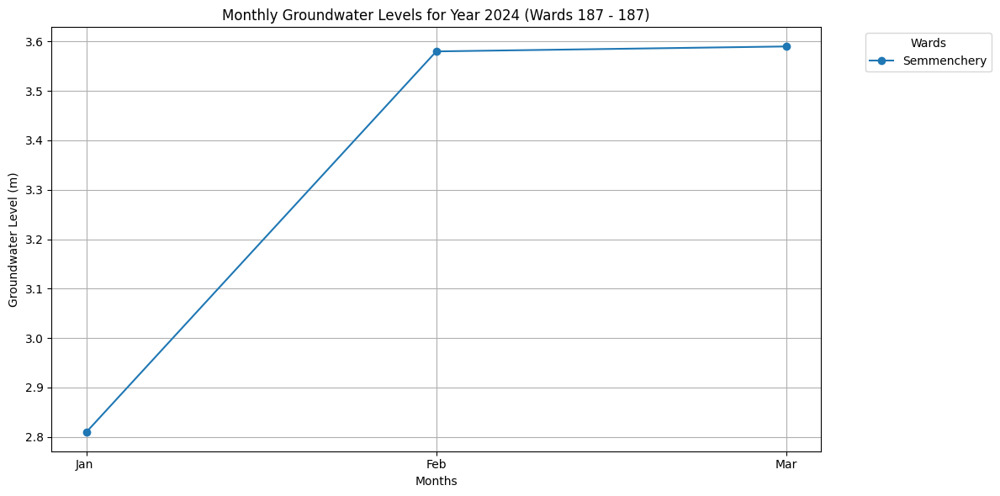

Yearly Averages Per Ward (Across All Years):
            Location  Year  Yearly Average
0        Kathivakkam  2021        1.788182
1        Kathivakkam  2021        3.213250
2           Ernavoor  2021        2.277083
3     Sadaiyankuppam  2021        3.478167
4    Kamadhenu Nagar  2021        3.776333
..               ...   ...             ...
195      Injampakkam  2024        5.663333
196       Karapakkam  2024        2.196667
197  Shozhinganallur  2024        5.630000
198          Uthandi  2024        1.326667
199      Semmenchery  2024        3.326667

[800 rows x 3 columns]

Overall Monthly Averages for Each Year:
          Jan        Feb       Mar      Apr        May       Jun       Jul  \
Year                                                                         
2021  5.409300  5.796600  6.167050  6.517600  6.733500  7.032550  6.434100   
2022  3.541206  3.991909  4.809385  5.465670  5.568550  5.102271  5.173106   
2023  4.226146  4.596798  4.696668  5.235829  5.584171  5.2752

In [18]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

# File paths for the 3 years (update with actual paths)
file_path_2021 = "./dataset/chennai-ground-water-levels-2021.csv"  # Replace with your file path for 2021
file_path_2022 = "./dataset/chennai-ground-water-levels-2022.csv"  # Replace with your file path for 2022
file_path_2023 = "./dataset/chennai-ground-water-levels-2023.csv"  # Replace with your file path for 2023
file_path_2024 = "./dataset/chennai-ground-water-levels-2024.csv"  # Replace with your file path for 2024

# Load the datasets for 2021, 2022, 2023, and 2024
df_2021 = pd.read_csv(file_path_2021)
df_2022 = pd.read_csv(file_path_2022)
df_2023 = pd.read_csv(file_path_2023)
df_2024 = pd.read_csv(file_path_2024)

# List of monthly columns
monthly_columns = ["Jan ", "Feb", "Mar", "Apr ", "May", "Jun", "Jul", "Aug", "Sep", "Oct", "Nov", "Dec"]

# Data Preparation: Ensure all datasets have the necessary columns
def prepare_data(df, year=None):
    # Fill missing months with NaN for the 2024 dataset
    if year == 2024:
        df[monthly_columns[3:]] = np.nan  # Set Apr-Dec to NaN for 2024
    df[monthly_columns] = df[monthly_columns].apply(pd.to_numeric, errors='coerce')
    df["Yearly Average"] = df[monthly_columns].mean(axis=1)
    return df

# Apply data preparation to all datasets
df_2021 = prepare_data(df_2021, year=2021)
df_2022 = prepare_data(df_2022, year=2022)
df_2023 = prepare_data(df_2023, year=2023)
df_2024 = prepare_data(df_2024, year=2024)

# Add Year Column for Identification
df_2021["Year"] = 2021
df_2022["Year"] = 2022
df_2023["Year"] = 2023
df_2024["Year"] = 2024

# Combine the datasets for 3 years
df_all_years = pd.concat([df_2021, df_2022, df_2023, df_2024])

# Step 3: Split Locations into Groups of 6
locations = df_all_years["Location"].unique()
num_plots = int(np.ceil(len(locations) / 6))  # Calculate number of plots needed

# Loop through each year and generate plots
years = [2021, 2022, 2023, 2024]
for year in years:
    df_year = df_all_years[df_all_years["Year"] == year]  # Filter data for the specific year

    for i in range(num_plots):
        plt.figure(figsize=(12, 6))
        
        start_idx = i * 6
        end_idx = start_idx + 6
        for location in locations[start_idx:end_idx]:  # Select 6 locations for each plot
            subset = df_year[df_year["Location"] == location]
            
            # Ensure we're using the correct row for this location and year
            values = subset[monthly_columns].iloc[0].values  # Access values directly for plotting
            
            plt.plot(monthly_columns, values, marker='o', label=location)

        plt.xlabel("Months")
        plt.ylabel("Groundwater Level (m)")
        plt.title(f"Monthly Groundwater Levels for Year {year} (Wards {start_idx + 1} - {min(end_idx, len(locations))})")
        plt.legend(loc='upper left', bbox_to_anchor=(1.05, 1), title="Wards")
        plt.grid()
        plt.tight_layout()
        plt.show()

# Step 4: Display Yearly Averages Per Ward (Optional)
print("Yearly Averages Per Ward (Across All Years):")
print(df_all_years[["Location", "Year", "Yearly Average"]])

# Step 5: Display Overall Monthly Averages for Each Year (Optional)
monthly_averages_all_years = df_all_years.groupby("Year")[monthly_columns].mean()
print("\nOverall Monthly Averages for Each Year:")
print(monthly_averages_all_years)


------

-----

In [20]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import os

# File paths for the 3 years (update with actual paths)
file_path_2021 = "./dataset/chennai-ground-water-levels-2021.csv"  # Replace with your file path for 2021
file_path_2022 = "./dataset/chennai-ground-water-levels-2022.csv"  # Replace with your file path for 2022
file_path_2023 = "./dataset/chennai-ground-water-levels-2023.csv"  # Replace with your file path for 2023
file_path_2024 = "./dataset/chennai-ground-water-levels-2024.csv"  # Replace with your file path for 2024

# Load the datasets for 2021, 2022, 2023, and 2024
df_2021 = pd.read_csv(file_path_2021)
df_2022 = pd.read_csv(file_path_2022)
df_2023 = pd.read_csv(file_path_2023)
df_2024 = pd.read_csv(file_path_2024)

# List of monthly columns
monthly_columns = ["Jan ", "Feb", "Mar", "Apr ", "May", "Jun", "Jul", "Aug", "Sep", "Oct", "Nov", "Dec"]

# Data Preparation: Ensure all datasets have the necessary columns
def prepare_data(df, year=None):
    # Fill missing months with NaN for the 2024 dataset
    if year == 2024:
        df[monthly_columns[3:]] = np.nan  # Set Apr-Dec to NaN for 2024
    df[monthly_columns] = df[monthly_columns].apply(pd.to_numeric, errors='coerce')
    df["Yearly Average"] = df[monthly_columns].mean(axis=1)
    return df

# Apply data preparation to all datasets
df_2021 = prepare_data(df_2021, year=2021)
df_2022 = prepare_data(df_2022, year=2022)
df_2023 = prepare_data(df_2023, year=2023)
df_2024 = prepare_data(df_2024, year=2024)

# Add Year Column for Identification
df_2021["Year"] = 2021
df_2022["Year"] = 2022
df_2023["Year"] = 2023
df_2024["Year"] = 2024

# Combine the datasets for 3 years
df_all_years = pd.concat([df_2021, df_2022, df_2023, df_2024])

# Create a directory to save images if it doesn't exist
output_dir = "Temp Anal of g water"
os.makedirs(output_dir, exist_ok=True)

# Step 3: Split Locations into Groups of 6
locations = df_all_years["Location"].unique()
num_plots = int(np.ceil(len(locations) / 6))  # Calculate number of plots needed

# Loop through each year and generate plots
years = [2021, 2022, 2023, 2024]
for year in years:
    df_year = df_all_years[df_all_years["Year"] == year]  # Filter data for the specific year

    for i in range(num_plots):
        plt.figure(figsize=(12, 6))
        
        start_idx = i * 6
        end_idx = start_idx + 6
        for location in locations[start_idx:end_idx]:  # Select 6 locations for each plot
            subset = df_year[df_year["Location"] == location]
            
            # Ensure we're using the correct row for this location and year
            values = subset[monthly_columns].iloc[0].values  # Access values directly for plotting
            
            plt.plot(monthly_columns, values, marker='o', label=location)

        # Prepare the plot title and filename
        plot_title = f"Monthly Groundwater Levels for Year {year} (Wards {start_idx + 1} - {min(end_idx, len(locations))})"
        plt.xlabel("Months")
        plt.ylabel("Groundwater Level (m)")
        plt.title(plot_title)
        plt.legend(loc='upper left', bbox_to_anchor=(1.05, 1), title="Wards")
        plt.grid()
        plt.tight_layout()

        # Save the plot as an image
        sanitized_title = plot_title.replace(" ", "_").replace(":", "").replace("(", "").replace(")", "")  # Sanitize title for filename
        plt.savefig(os.path.join(output_dir, f"{sanitized_title}.png"))
        plt.close()  # Close the figure to avoid displaying it in the notebook

# Step 4: Display Yearly Averages Per Ward (Optional)
print("Yearly Averages Per Ward (Across All Years):")
print(df_all_years[["Location", "Year", "Yearly Average"]])

# Step 5: Display Overall Monthly Averages for Each Year (Optional)
monthly_averages_all_years = df_all_years.groupby("Year")[monthly_columns].mean()
print("\nOverall Monthly Averages for Each Year:")
print(monthly_averages_all_years)


Yearly Averages Per Ward (Across All Years):
            Location  Year  Yearly Average
0        Kathivakkam  2021        1.788182
1        Kathivakkam  2021        3.213250
2           Ernavoor  2021        2.277083
3     Sadaiyankuppam  2021        3.478167
4    Kamadhenu Nagar  2021        3.776333
..               ...   ...             ...
195      Injampakkam  2024        5.663333
196       Karapakkam  2024        2.196667
197  Shozhinganallur  2024        5.630000
198          Uthandi  2024        1.326667
199      Semmenchery  2024        3.326667

[800 rows x 3 columns]

Overall Monthly Averages for Each Year:
          Jan        Feb       Mar      Apr        May       Jun       Jul  \
Year                                                                         
2021  5.409300  5.796600  6.167050  6.517600  6.733500  7.032550  6.434100   
2022  3.541206  3.991909  4.809385  5.465670  5.568550  5.102271  5.173106   
2023  4.226146  4.596798  4.696668  5.235829  5.584171  5.2752